In [3]:
# change the directory to EC523_Project_G
%cd ..
%pwd

/Users/ender_yang/Desktop/BU/0.25Spring/CS523/Final_Project/EC523_Project_G


'/Users/ender_yang/Desktop/BU/0.25Spring/CS523/Final_Project/EC523_Project_G'

In [1]:
PHASE3_SCENE_DESCRIPTION_FILE = "./DATASET/PROCESSING_RECORD_PHASE3_SCENE_DESCRIPTION.json"

In [ ]:
import json
from pathlib import Path
import shutil
from copy import deepcopy


with open(PHASE3_SCENE_DESCRIPTION_FILE, "r") as f:
    phase3_record = json.load(f)


In [143]:
scene_path_list = []
inpainting_image_path_list = []
fiugre_path_list = []
description_list = []

for series_name in phase3_record["dataset_dict"].keys():
    print(f"series_name: {series_name}")
    for ep_name in phase3_record["dataset_dict"][series_name].keys():
        print(f"\t ep_name: {ep_name}")
        ep = phase3_record["dataset_dict"][series_name][ep_name]
        for idx_scene, scene in enumerate(ep):
            # print(idx_scene)
            # print(scene.keys())
            print(f"\t\t scene idx: {idx_scene}")
            scene_data = scene["scene_data"]
            
            scene_path_list.append(scene_data["image_path_scene"])
            inpainting_image_path_list.append(scene_data["image_path_inpainting"])
            fiugre_path_list.append(scene_data["image_path_cropped_figures_with_bbox_segmt"])
            description_list.append(scene_data["image_scene_llava_description"])

            print(f"\t\t {scene_data['image_path_cropped_figures_with_bbox_segmt']}")

            print(f"\t\t scene_data: {scene_data.keys()}")
            print(f"\t\t image_scene_llama_description: {scene_data['image_scene_llava_description']}")
            print(f"\t\t image_path_inpainting: {scene_data['image_path_inpainting']}")
            print(f"\t\t image_path_scene: {scene_data['image_path_scene']}")
            print("\n")


series_name: cute
	 ep_name: cute08
		 scene idx: 0
		 [{'bbox': [287, 0, 1464, 1081], 'instance_id': 0, 'color': [16, 16, 255], 'img_path': 'DATASET/CROPPED_FIGURES/cute/cute08/scene_00000/figure_mask_00000.png', 'mask_path': 'DATASET/CROPPED_FIGURES/cute/cute08/scene_00000/figure_mask_00000.png'}]
		 scene_data: dict_keys(['image_path_scene', 'image_path_segmt', 'image_path_cropped_figures_with_bbox_segmt', 'image_path_instance_removed', 'image_path_inpainting', 'subtitles_5_before', 'subtitles_5_after', 'image_scene_llava_description', 'video_time_in_seconds'])
		 image_scene_llama_description: [{'prompt': '<image>\nUSER: \nmake a story out of the figures in the scene, adding interactions happens previously till this scene. Using a definite tone without might or could. Adding details to the story without "or" just choose an event.\n\nASSISTANT:', 'description': '\nUSER: \nmake a story out of the figures in the scene, adding interactions happens previously till this scene. Using a de

In [144]:
# print(f"len(scene_path_list): {len(scene_path_list)}")
# print(f"len(image_path_list): {len(image_path_list)}")
# print(f"len(fiugre_path_list): {len(fiugre_path_list)}")
# print(f"len(description_list): {len(description_list)}")

# print(fiugre_path_list)
import numpy as np
figure_count = []
for x in fiugre_path_list:
    # print(len(x))
    figure_count.append(len(x))
unique, counts = np.unique(figure_count, return_counts=True)
for u, c in zip(unique, counts):
    print(f"u: {u}, c: {c}")
    if u > 2:
        break

print(scene_path_list[0])
i = 0
print(len(inpainting_image_path_list[0]), inpainting_image_path_list[0][i]["path"])
print(len(fiugre_path_list[0]), fiugre_path_list[0][i]["img_path"])
# prefix_len = len(description_list[0][i]["prompt"])
# print(prefix_len)
# print(len(description_list[0]), description_list[0][i]["description"])

print("\n\n\n", description_list[0][i]["description"].split("ASSISTANT:")[1])

# print("\n\n\n", description_list[0][i]["prompt"])

u: 1, c: 2086
u: 2, c: 1797
u: 3, c: 498
DATASET/SCENE/cute/cute08/scene_00000.png
6 DATASET/INPAINTING_IMAGE/cute/cute08/scene_00000/inpainting_00000.png
1 DATASET/CROPPED_FIGURES/cute/cute08/scene_00000/figure_mask_00000.png



  In the image, a woman with red hair and a pink shirt is standing in front of a door, looking at the camera. She appears to be the main focus of the scene. The woman is wearing a white shirt, which contrasts with her red hair.

Previously, the woman had been engaged in a conversation with a man who was standing behind her. They were discussing a topic that was important to both of them. The man was wearing a black shirt, which complemented his dark hair.

As the conversation progressed, the woman noticed a book on a surface nearby. She picked it up and began to read it, while the man observed her actions. The book was about a fascinating subject that caught the woman's interest, and she was eager to learn more.

The scene captures a moment of curiosity and le

In [178]:
import torch
import torch.nn.functional as F


def random_pad_to_size(image, size=(256,256), transform=None):
    target_height, target_width = size
    
    image = torch.tensor(image)
    if transform is not None:
        image = transform(image)
    # Getting the original size
    C, H, W = image.shape
    ratio = max(H / size[0], W / size[1])
    if ratio > 1:
        print("ratio: ", ratio)
        image = F.interpolate(image[None], size=(int(H/ratio), int(W/ratio)), mode='bilinear', align_corners=False)[0]
    # print(image.shape)
    C, H, W = image.shape

    # Calculating the padding needed
    padding_height = max(target_height - H, 0)
    padding_width = max(target_width - W, 0)

    # Distributing the padding on both sides randomly
    top_pad = torch.randint(0, padding_height + 1, (1,)).item()
    bottom_pad = padding_height - top_pad

    left_pad = torch.randint(0, padding_width + 1, (1,)).item()
    right_pad = padding_width - left_pad

    # Applying the padding
    # Pad format is (left, right, top, bottom)
    padded_image = F.pad(image, (left_pad, right_pad, top_pad, bottom_pad), 'constant', 0)

    # Verify the size
    assert padded_image.size(1) == 256 and padded_image.size(2) == 256, "Image was not properly padded."

    padded_image = padded_image.numpy()
    return padded_image



# C, H, W = 3, 300, 150  # Example dimensions
# image = torch.rand(C, H, W)  # Random image

# padded_image = random_pad_to_size(image, size=(256, 256))

# print(f"Original size: {H}x{W}, New size: {padded_image.size(1)}x{padded_image.size(2)}")


In [184]:

from torch.utils.data import Dataset, DataLoader
import torch
import PIL
from PIL import Image
from pathlib import Path
import torchvision

class FigureSceneDataset(Dataset):
    def __init__(self, scene_path_list, inpainting_image_path_list, fiugre_path_list, description_list, MAX_NUM_FIGURE=5, dataset_path="./", figure_transform_flag = False):
        self.scene_path_list = scene_path_list
        self.inpainting_image_path_list = inpainting_image_path_list
        self.figure_path_list = fiugre_path_list
        self.MAX_NUM_FIGURE = MAX_NUM_FIGURE
        self.description_list = description_list

        self.dataset_path = dataset_path
        self.figure_transform_flag = figure_transform_flag

    def __len__(self):
        return len(self.scene_path_list)

    def __getitem__(self, idx):
        print(idx)
        scene_path = self.scene_path_list[idx]
        inpainting_image_path_list = self.inpainting_image_path_list[idx]
        figure_path = self.figure_path_list[idx]
        descriptions = self.description_list[idx]

        scene_img = Image.open(Path(self.dataset_path) / scene_path)
        scene_img = scene_img.convert("RGB")
        scene_img = scene_img.resize((256, 256))
        scene_img = np.array(scene_img) / 255.0

        len_inpainting_image = len(inpainting_image_path_list)
        i = np.random.randint(0, len_inpainting_image)
        inpainting_image_path = inpainting_image_path_list[i]["path"]
        inpainting_img = Image.open(Path(self.dataset_path) / inpainting_image_path)
        inpainting_img = inpainting_img.convert("RGB")
        inpainting_img = inpainting_img.resize((256,256))
        inpainting_img = np.array(inpainting_img) / 255.0

        # figure_img_list = []
        figure_img_list = np.zeros((self.MAX_NUM_FIGURE, 3, 256, 256))
        len_figure = min(len(figure_path), self.MAX_NUM_FIGURE)
        for i_figure, path in enumerate(figure_path):
            figure_img_path = path["img_path"].replace("mask_", "")
            figure_img = Image.open(Path(self.dataset_path) / figure_img_path)
            figure_img = figure_img.convert("RGB")
            figure_img = np.array(figure_img).transpose(2, 0, 1)


            if self.figure_transform_flag == True:
                figure_transform = torchvision.transforms.Compose([
                    torchvision.transforms.RandomAffine(degrees=15, translate=(0.1, 0.1), scale=(0.9, 1.1), shear=0, interpolation=torchvision.transforms.InterpolationMode.BILINEAR, fill=0),
                    # torch.transforms.Resize((256, 256)),
                    torchvision.transforms.RandomHorizontalFlip(),
                    # torch.transforms.ToTensor(),
                    # torch.transforms.Normalize(mean=[0.485, 0.456, 0.406],
                    #                            std=[0.229, 0.224, 0.225])
                ])
            else:
                figure_transform = None

            figure_img = random_pad_to_size(figure_img, size=(256, 256), transform=figure_transform)
            figure_img_list[i_figure] = figure_img / 255.0
            if (i_figure+1) == len_figure:
                break
            # plt.imshow(figure_img_list[i_figure].transpose(1, 2, 0))
            # print(figure_img.shape)

        # len_figure = len(fiugre_path)
        # i = np.random.randint(0, len_figure)
        # figure_img = PIL.Image.open(Path(self.dataset_path) / figure_path[i]["img_path"])

        len_descriptions = len(descriptions)
        i = np.random.randint(0, len_descriptions)
        description = descriptions[i]["description"].split("ASSISTANT:")[1]

        # return self.scene_path_list[idx], self.image_path_list[idx], self.fiugre_path_list[idx], self.description_list[idx]
        return scene_img, inpainting_img, figure_img_list, description, len_figure

### Batch size = 1

In [185]:
figure_scene_dataset = FigureSceneDataset(scene_path_list, inpainting_image_path_list, fiugre_path_list, description_list, dataset_path="./", MAX_NUM_FIGURE=5)
figure_scene_dataloader_B1 = DataLoader(figure_scene_dataset, batch_size=1, shuffle=False)

In [193]:
figure_scene_dataloader_B1_iter = iter(figure_scene_dataloader_B1)

In [196]:
data = next(figure_scene_dataloader_B1_iter)

1
ratio:  2.51953125
ratio:  3.765625


 In the image, a young woman with pink hair is standing in a room, looking at a man who is sitting at a desk. The man is holding a laptop, and the woman appears to be observing him. The room is furnished with a couch, a chair, and a TV. The woman and the man have a history of interaction, and they have been friends for a long time.

Recently, the man had been working on a project, and the woman had been helping him with it. They had spent countless hours together, discussing ideas, and solving problems. The man had been using the laptop to work on the project, and the woman had been observing his progress.

One day, the man had a breakthrough, and he decided to show the woman what he had accomplished. He opened the laptop and began to explain his findings. The woman listened attentively, and she was impressed by the man's work. She had never seen him so focused and determined.

The man and the woman had a conversation about the project, and they discussed the next steps. They were both

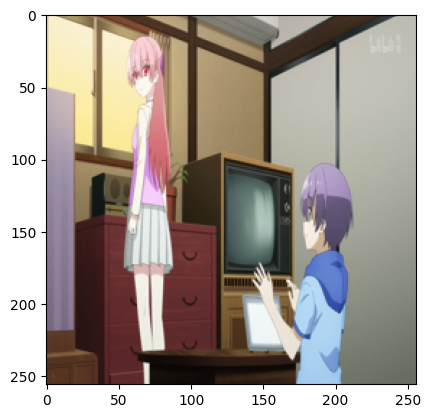

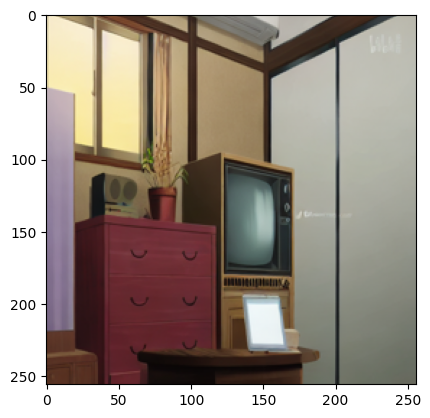

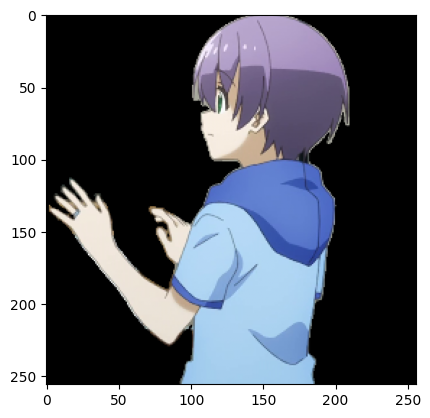

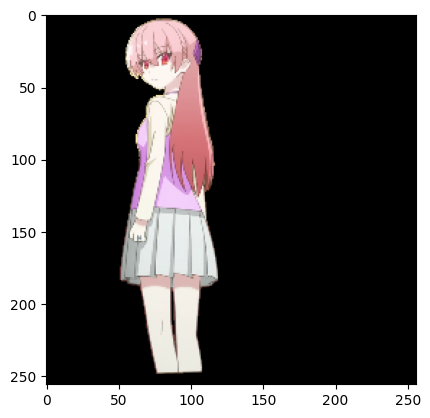

In [197]:
from matplotlib import pyplot as plt

scene_img, inpainting_img, figure_img_list, description, num_figure = data

# print(scene_img.shape)
plt.figure()
plt.imshow(scene_img[0])

plt.figure()
plt.imshow(inpainting_img[0])


len_figure = len(figure_img_list[0])
for i in range(num_figure):
    plt.figure()
    plt.imshow(figure_img_list[0][i].permute(1,2,0))
# print(figure_img_list.shape)
# print(figure_img_list[0][0].shape)
# # print(figure_img_list[0][0].shape)
# # plt.figure()
# # plt.imshow(figure_img_list[0][0].permute(1,2,0))

print(description[0])

### Batch Size = 4

In [189]:
figure_scene_dataset = FigureSceneDataset(scene_path_list, inpainting_image_path_list, fiugre_path_list, description_list, dataset_path="./")
figure_scene_dataloader = DataLoader(figure_scene_dataset, batch_size=4, shuffle=False)

In [190]:
figure_scene_dataloader_iter = iter(figure_scene_dataloader)

In [191]:
data = next(figure_scene_dataloader_iter)
scene_img, inpainting_img, figure_img_list, description, num_figure = data

print(scene_img.shape)
print(inpainting_img.shape)
print(figure_img_list.shape)
print(description)
print(num_figure)

# print(type(figure_img_list))

0
ratio:  5.71875
1
ratio:  2.51953125
ratio:  3.765625
2
ratio:  5.296875
3
ratio:  5.29296875
torch.Size([4, 256, 256, 3])
torch.Size([4, 256, 256, 3])
torch.Size([4, 5, 3, 256, 256])
(" In the image, a woman with red hair and a pink shirt is standing in front of a door, looking at the camera. She appears to be the main focus of the scene. The woman is wearing a white shirt, which contrasts with her red hair.\n\nPreviously, the woman had been engaged in a conversation with a man who was standing behind her. They were discussing a topic that was important to both of them. The man was wearing a black shirt, which complemented his dark hair.\n\nAs the conversation progressed, the woman noticed a book on a surface nearby. She picked it up and began to read it, while the man observed her actions. The book was about a fascinating subject that caught the woman's interest, and she was eager to learn more.\n\nThe scene captures a moment of curiosity and learning, as the woman explores the boo